In [2]:
%pip install basemap

import matplotlib.pyplot as plt
from mpl_toolkits.basemap import Basemap  # or import cartopy.crs as ccrs, cartopy.feature as cfeature
import pandas as pd

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 569.9/569.9 kB 8.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 30.5/30.5 MB 6.7 MB/s eta 0:00:00a 0:00:01
Note: you may need to restart the kernel to use updated packages.


In [20]:

pip install tifffile

Note: you may need to restart the kernel to use updated packages.


In [21]:
import os
import glob
import imageio
import matplotlib.pyplot as plt
import numpy as np
from PIL import Image
import tifffile

In [2]:
import pandas as pd
import matplotlib.pyplot as plt
import imageio
import os

csv_file=pd.read_csv('/Users/varshap/Downloads/ST5188/Data/Final/CHANGI.csv')

Error processing date 2013-04-24: [Errno 30] Read-only file system: '/frame_001.png'
Error processing date 2013-06-27: [Errno 30] Read-only file system: '/frame_002.png'
Error processing date 2013-07-29: [Errno 30] Read-only file system: '/frame_003.png'
Error processing date 2013-08-30: [Errno 30] Read-only file system: '/frame_004.png'
Error processing date 2013-10-01: [Errno 30] Read-only file system: '/frame_005.png'
Error processing date 2013-10-17: [Errno 30] Read-only file system: '/frame_006.png'
Error processing date 2014-02-06: [Errno 30] Read-only file system: '/frame_007.png'
Error processing date 2014-02-22: [Errno 30] Read-only file system: '/frame_008.png'
Error processing date 2014-03-10: [Errno 30] Read-only file system: '/frame_009.png'
Error processing date 2014-03-26: [Errno 30] Read-only file system: '/frame_010.png'
Error processing date 2014-04-11: [Errno 30] Read-only file system: '/frame_011.png'
Error processing date 2014-05-13: [Errno 30] Read-only file syste

/var/folders/xp/9gp1l50s3ksg8hvg7ydc3vjr0000gn/T/ipykernel_29795/2481362061.py:28: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(8, 6))


Error processing date 2015-02-09: [Errno 30] Read-only file system: '/frame_023.png'
Error processing date 2015-02-25: [Errno 30] Read-only file system: '/frame_024.png'
Error processing date 2015-03-13: [Errno 30] Read-only file system: '/frame_025.png'
Error processing date 2015-03-29: [Errno 30] Read-only file system: '/frame_026.png'
Error processing date 2015-04-14: [Errno 30] Read-only file system: '/frame_027.png'
Error processing date 2015-04-30: [Errno 30] Read-only file system: '/frame_028.png'
Error processing date 2015-05-16: [Errno 30] Read-only file system: '/frame_029.png'
Error processing date 2015-06-01: [Errno 30] Read-only file system: '/frame_030.png'
Error processing date 2015-06-17: [Errno 30] Read-only file system: '/frame_031.png'
Error processing date 2015-07-03: [Errno 30] Read-only file system: '/frame_032.png'
Error processing date 2015-08-20: [Errno 30] Read-only file system: '/frame_033.png'
Error processing date 2015-09-05: [Errno 30] Read-only file syste

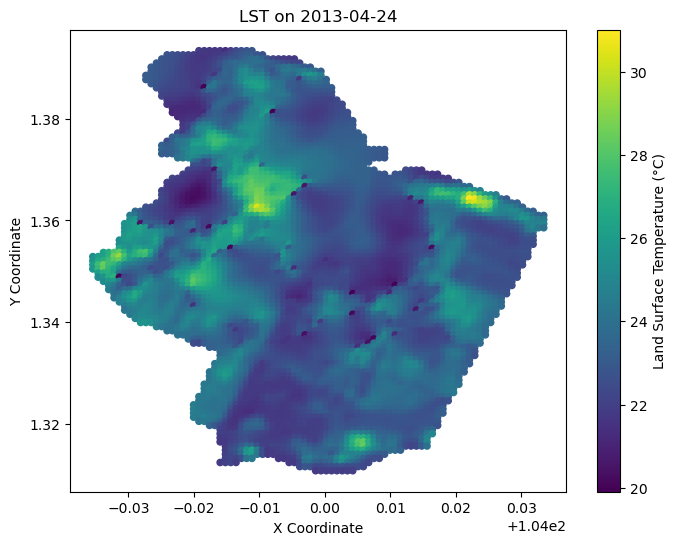

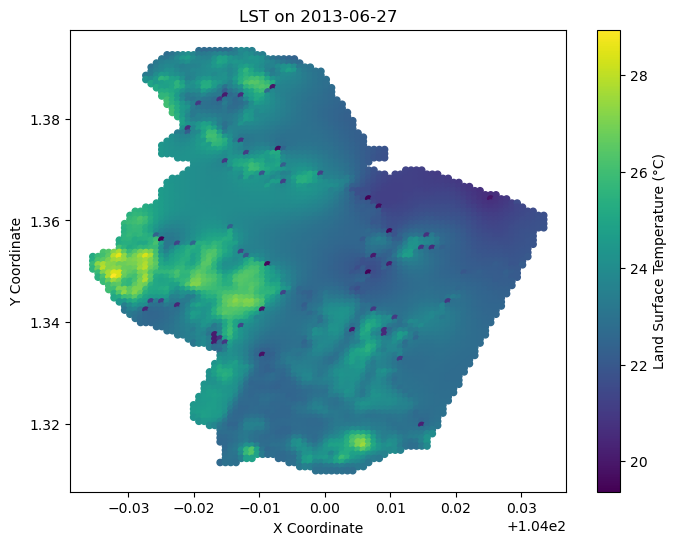

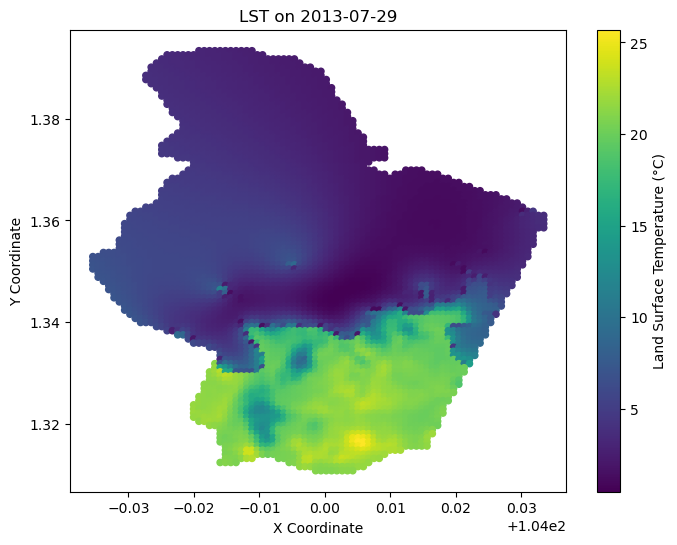

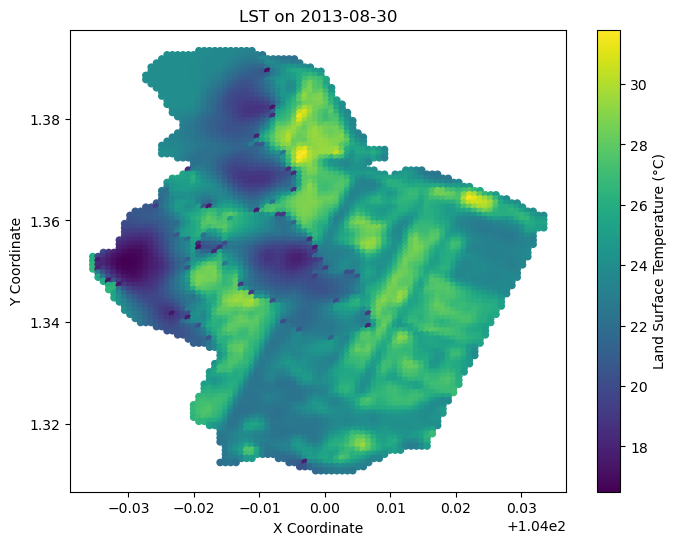

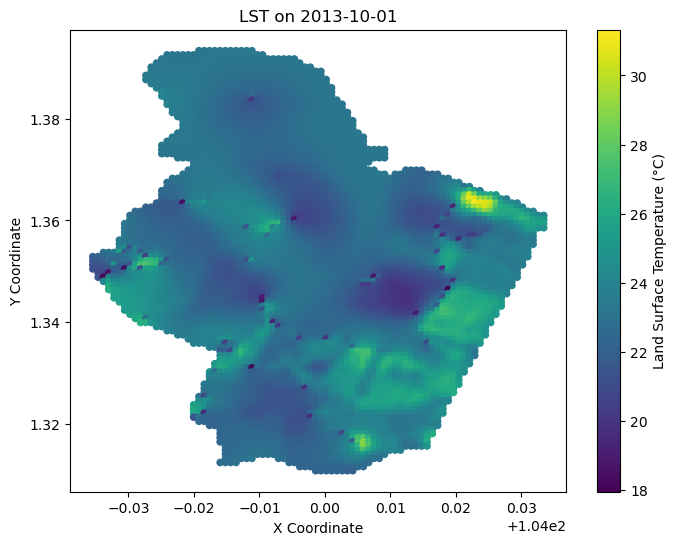

...

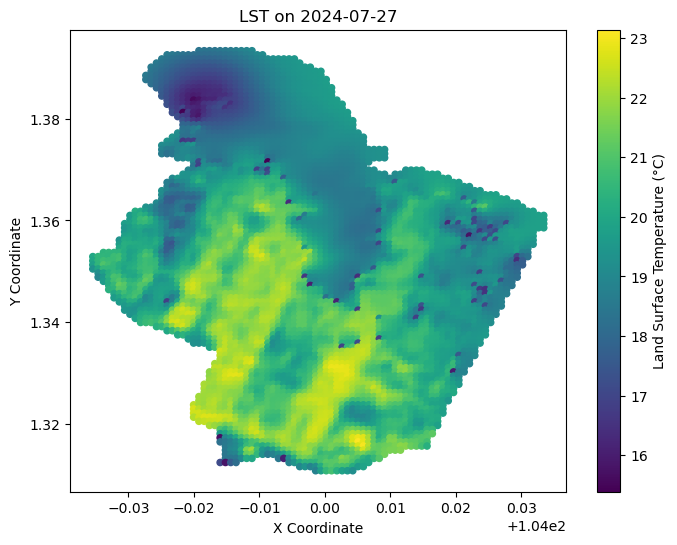

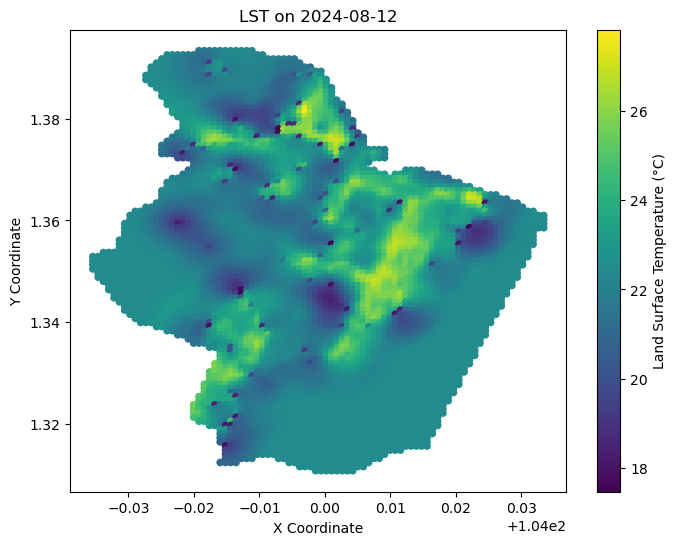

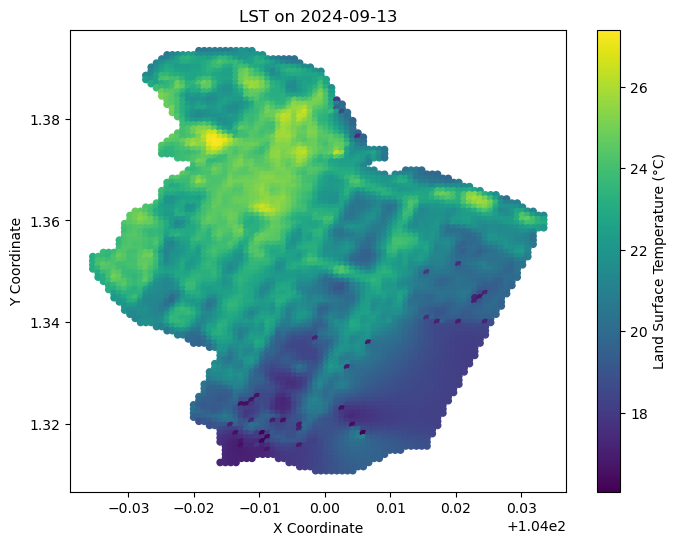

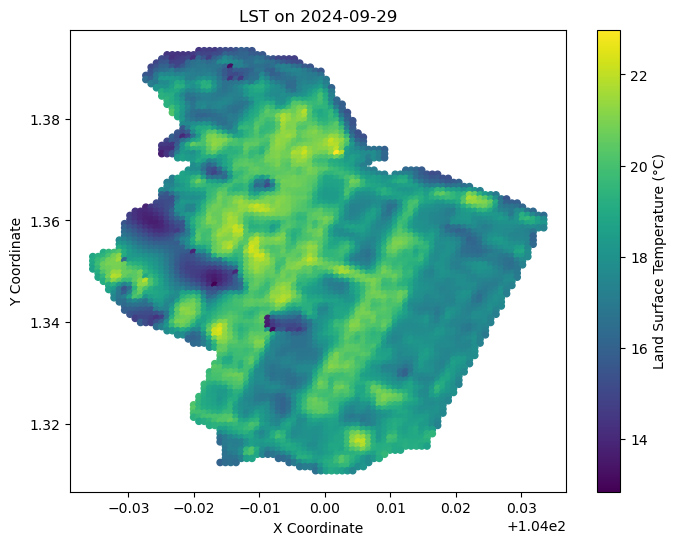

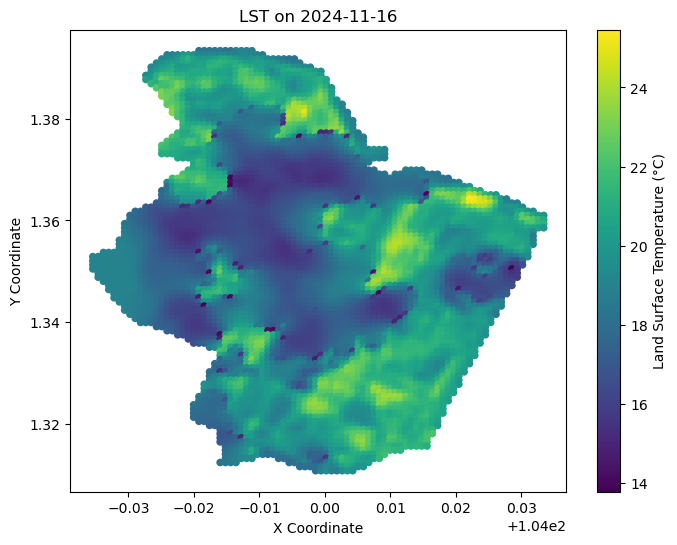

In [36]:

def create_lst_animation_single_csv_date(csv_file, output_gif, date_column, fps=5):
    """
    Creates an animation of LST data from a single CSV file with a date column.

    Args:
        csv_file (str): Path to the CSV file.
        output_gif (str): Path to save the output GIF animation.
        date_column (str): Name of the column representing dates.
        fps (int): Frames per second for the animation.
    """

    try:
        df = pd.read_csv(csv_file)
    except FileNotFoundError:
        print(f"CSV file not found: {csv_file}")
        return

    image_files = []
    date_steps = df[date_column].unique()

    for i, date_step in enumerate(date_steps):
        try:
            date_df = df[df[date_column] == date_step]
            x = date_df['x'].values
            y = date_df['y'].values
            lst = date_df['LST'].values

            plt.figure(figsize=(8, 6))
            plt.scatter(x, y, c=lst, cmap='viridis', s=20)
            plt.colorbar(label='Land Surface Temperature (°C)')
            plt.title(f'LST on {date_step}')
            plt.xlabel('X Coordinate')
            plt.ylabel('Y Coordinate')

            image_file = f'frame_{i+1:03d}.png'
            plt.savefig(image_file)
            plt.close()

            image_files.append(image_file)

        except Exception as e:
            print(f"Error processing date {date_step}: {e}")
            continue

    if image_files:
        images = [imageio.imread(file) for file in image_files]
        imageio.mimsave(output_gif, images, fps=fps)
        print(f"Animation saved to {output_gif}")

        # Clean up temporary image files
        for file in image_files:
            os.remove(file)
    else:
        print("No images to create animation.")

# Example usage:
csv_file = "/Users/varshap/Downloads/ST5188/Data/Final/CHANGI.csv"  # Replace with your CSV file path
output_gif = "lst_animation.gif"
date_column = "date"  # Replace with the actual name of your date column
create_lst_animation_single_csv_date(csv_file, output_gif, date_column)

In [38]:
import pandas as pd
import matplotlib.pyplot as plt
import imageio
import numpy as np
import os
import tempfile

def create_lst_animation_large_csv(csv_file, output_gif, date_column, grid_size=100, fps=5):
    """Creates an animation from a large CSV using chunking and heatmaps."""

    writer = imageio.get_writer(output_gif, fps=fps)

    with tempfile.TemporaryDirectory() as temp_dir: #create temporary directory.

        for chunk in pd.read_csv(csv_file, chunksize=100000):
            date_steps = chunk[date_column].unique()

            for i, date_step in enumerate(date_steps):
                date_df = chunk[chunk[date_column] == date_step]
                x = date_df['x'].values
                y = date_df['y'].values
                lst = date_df['LST'].values

                heatmap, xedges, yedges = np.histogram2d(x, y, weights=lst, bins=grid_size)
                counts, _, _ = np.histogram2d(x,y, bins=grid_size)
                heatmap[counts>0] = heatmap[counts>0]/counts[counts>0]
                heatmap = np.nan_to_num(heatmap.T)

                plt.figure(figsize=(8, 6))
                plt.imshow(heatmap, origin='lower', extent=[xedges[0], xedges[-1], yedges[0], yedges[-1]], cmap='viridis')
                plt.colorbar(label='Land Surface Temperature (°C)')
                plt.title(f'LST on {date_step}')
                plt.xlabel('X Coordinate')
                plt.ylabel('Y Coordinate')

                image_file = os.path.join(temp_dir, f'frame_{i+1:03d}.png') #save to temp dir.
                plt.gca().set_axis_off()
                plt.tight_layout(pad=0)
                plt.savefig(image_file)
                plt.close()

                # Read frame from temp dir and write to gif.
                image = imageio.imread(image_file)
                writer.append_data(image)

        writer.close()
        print(f"Animation saved to {output_gif}")

# Example usage:
#csv_file = "your_large_data.csv"
import tempfile

with tempfile.TemporaryDirectory() as temp_dir:
    output_gif = os.path.join(temp_dir, "lst_animation_heatmap.gif")
    date_column = "date"
    create_lst_animation_large_csv(csv_file, output_gif, date_column)

/var/folders/xp/9gp1l50s3ksg8hvg7ydc3vjr0000gn/T/ipykernel_29795/547455481.py:43: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(image_file)
/var/folders/xp/9gp1l50s3ksg8hvg7ydc3vjr0000gn/T/ipykernel_29795/547455481.py:43: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(image_file)
Exception ignored in: <function PluginV3.__del__ at 0x15f8477e0>
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.12/site-packages/imageio/core/v3_plugin_api.py", line 370, in __del__
    self.close()
  File "/opt/anaconda3/lib/python3.12/site

Animation saved to /var/folders/xp/9gp1l50s3ksg8hvg7ydc3vjr0000gn/T/tmp2s6v0n2p/lst_animation_heatmap.gif
